#**DETR Fine Tuning**

##Initial setup

In [ ]:
!nvidia-smi

Wed Mar 30 17:47:41 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.32.03    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   44C    P0    28W / 250W |      2MiB / 16280MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
%cd /content/drive/MyDrive/[Project]_MachineLearningAndDataAnalytics/DETR

/content/drive/MyDrive/ML_project/DETR_kaggle_masks_fine_tune


In [ ]:
!mkdir weights

In [ ]:
%cd weights

In [ ]:
!wget https://dl.fbaipublicfiles.com/detr/detr-r50-e632da11.pth

In [ ]:
import torch 
pretrained_weights = torch.load('detr-r50-e632da11.pth')
#removing the weights of the last layer in the pretrained model
del pretrained_weights["model"]["class_embed.weight"]
del pretrained_weights["model"]["class_embed.bias"]
del pretrained_weights["model"]["query_embed.weight"]
torch.save(pretrained_weights, 'detr-r50-e632da11_mod.pth')

In [ ]:
%cd ../

##Training

In [ ]:
%cd /content/drive/MyDrive/[Project]_MachineLearningAndDataAnalytics/DETR

/content/drive/MyDrive/[Project]_MachineLearningAndDataAnalytics/DETR


In [ ]:
!python3 main.py --dataset_file face --data_path ../Datesets --output_dir output --resume /weights/detr-r50-e632da11_mod.pth --epochs 100

Not using distributed mode
git:
  sha: 8a144f83a287f4d3fece4acdf073f387c5af387d, status: has uncommited changes, branch: main

Namespace(aux_loss=True, backbone='resnet50', batch_size=2, bbox_loss_coef=5, clip_max_norm=0.1, coco_panoptic_path=None, data_path='../dataset_masks_v2/', dataset_file='face', dec_layers=6, device='cuda', dice_loss_coef=1, dilation=False, dim_feedforward=2048, dist_url='env://', distributed=False, dropout=0.1, enc_layers=6, eos_coef=0.1, epochs=100, eval=False, frozen_weights=None, giou_loss_coef=2, hidden_dim=256, lr=0.0001, lr_backbone=1e-05, lr_drop=200, mask_loss_coef=1, masks=False, nheads=8, num_queries=100, num_workers=2, output_dir='output2', position_embedding='sine', pre_norm=False, remove_difficult=False, resume='output/checkpoint.pth', seed=42, set_cost_bbox=5, set_cost_class=1, set_cost_giou=2, start_epoch=50, weight_decay=0.0001, world_size=1)
number of params: 41280009
loading annotations into memory...
Done (t=0.01s)
creating index...
index cre

##Evaluation

In [ ]:
%cd /content/drive/MyDrive/[Project]_MachineLearningAndDataAnalytics/DETR

/content/drive/MyDrive/[Project]_MachineLearningAndDataAnalytics/DETR


In [ ]:
!python main.py --batch_size 2 --no_aux_loss --eval --resume output/checkpoint0099.pth  --dataset_file face --data_path ../Datesets

Not using distributed mode
git:
  sha: 8a144f83a287f4d3fece4acdf073f387c5af387d, status: has uncommited changes, branch: main

Namespace(aux_loss=False, backbone='resnet50', batch_size=2, bbox_loss_coef=5, clip_max_norm=0.1, coco_panoptic_path=None, data_path='../Datesets', dataset_file='face', dec_layers=6, device='cuda', dice_loss_coef=1, dilation=False, dim_feedforward=2048, dist_url='env://', distributed=False, dropout=0.1, enc_layers=6, eos_coef=0.1, epochs=200, eval=True, frozen_weights=None, giou_loss_coef=2, hidden_dim=256, lr=0.0001, lr_backbone=1e-05, lr_drop=200, mask_loss_coef=1, masks=False, nheads=8, num_queries=100, num_workers=2, output_dir='', position_embedding='sine', pre_norm=False, remove_difficult=False, resume='output/checkpoint0099.pth', seed=42, set_cost_bbox=5, set_cost_class=1, set_cost_giou=2, start_epoch=0, weight_decay=0.0001, world_size=1)
Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet

##Plots

In [ ]:
%cd /content/drive/MyDrive/[Project]_MachineLearningAndDataAnalytics/DETR

/content/drive/MyDrive/[Project]_MachineLearningAndDataAnalytics/DETR


In [ ]:
from util.plot_utils import plot_logs
from matplotlib import pyplot as plt
from pathlib import Path

log_directory = [Path('output/')]

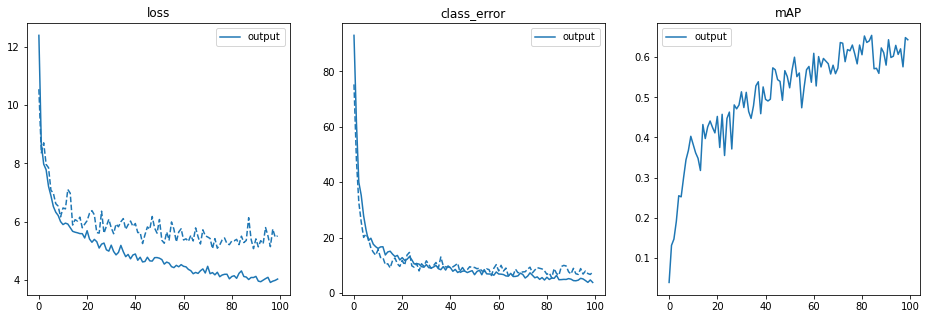

In [ ]:
fields_of_interest = (
    'loss',
    'class_error',
    'mAP',
    )

plot_logs(log_directory,
          fields_of_interest)

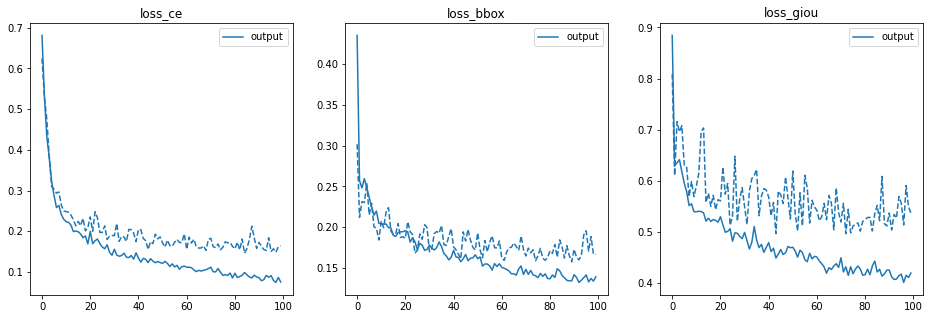

In [ ]:
fields_of_interest = (
    'loss_ce',
    'loss_bbox',
    'loss_giou',
    )

plot_logs(log_directory,
          fields_of_interest)

##Testing Demo

In [ ]:
import torch
model = torch.hub.load('facebookresearch/detr',
                       'detr_resnet50',
                       pretrained=False,
                       num_classes=4)

checkpoint = torch.load('output/checkpoint0099.pth',
                        map_location='cpu')

model.load_state_dict(checkpoint['model'],
                      strict=False)

model.eval();

Using cache found in /root/.cache/torch/hub/facebookresearch_detr_main


In [ ]:
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())

torch.set_grad_enabled(False);

1.10.0+cu111 True


In [ ]:
import torchvision.transforms as T

# standard PyTorch mean-std input image normalization
transform = T.Compose([
    T.Resize(800),
    T.ToTensor(),
    T.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

# for output bounding box post-processing
def box_cxcywh_to_xyxy(x):
    x_c, y_c, w, h = x.unbind(1)
    b = [(x_c - 0.5 * w), (y_c - 0.5 * h),
         (x_c + 0.5 * w), (y_c + 0.5 * h)]
    return torch.stack(b, dim=1)

def rescale_bboxes(out_bbox, size):
    img_w, img_h = size
    b = box_cxcywh_to_xyxy(out_bbox)
    b = b * torch.tensor([img_w, img_h, img_w, img_h], dtype=torch.float32)
    return b

In [ ]:
def filter_bboxes_from_outputs(outputs,
                               threshold=0.7):
  
  # keep only predictions with confidence above threshold
  probas = outputs['pred_logits'].softmax(-1)[0, :, :-1]
  keep = probas.max(-1).values > threshold

  probas_to_keep = probas[keep]

  # convert boxes from [0; 1] to image scales
  bboxes_scaled = rescale_bboxes(outputs['pred_boxes'][0, keep], im.size)
  
  return probas_to_keep, bboxes_scaled

In [ ]:
COLORS = [[0.000, 0.447, 0.741], [0.850, 0.325, 0.098], [0.929, 0.694, 0.125],
          [0.494, 0.184, 0.556], [0.466, 0.674, 0.188], [0.301, 0.745, 0.933]]

In [ ]:
finetuned_classes = [
      'pic', 'mask_wore_incorrect', 'with_mask', 'without_mask'
  ]

In [ ]:
def plot_finetuned_results(pil_img, prob=None, boxes=None):
    plt.figure(figsize=(16,10))
    plt.imshow(pil_img)
    ax = plt.gca()
    colors = COLORS * 100
    if prob is not None and boxes is not None:
      for p, (xmin, ymin, xmax, ymax), c in zip(prob, boxes.tolist(), colors):
          ax.add_patch(plt.Rectangle((xmin, ymin), xmax - xmin, ymax - ymin,
                                    fill=False, color=c, linewidth=3))
          cl = p.argmax()
          text = f'{finetuned_classes[cl]}: {p[cl]:0.2f}'
          ax.text(xmin, ymin, text, fontsize=15,
                  bbox=dict(facecolor='yellow', alpha=0.5))
    plt.axis('off')
    plt.show()

In [ ]:
def run_worflow(my_image, my_model):
  # mean-std normalize the input image (batch-size: 1)
  img = transform(my_image).unsqueeze(0)

  # propagate through the model
  outputs = my_model(img)

  for threshold in [0.5]:
    
    probas_to_keep, bboxes_scaled = filter_bboxes_from_outputs(outputs,
                                                              threshold=threshold)

    plot_finetuned_results(my_image,
                           probas_to_keep, 
                           bboxes_scaled)

/root/.cache/torch/hub/facebookresearch_detr_main/models/position_encoding.py:41: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  dim_t = self.temperature ** (2 * (dim_t // 2) / self.num_pos_feats)


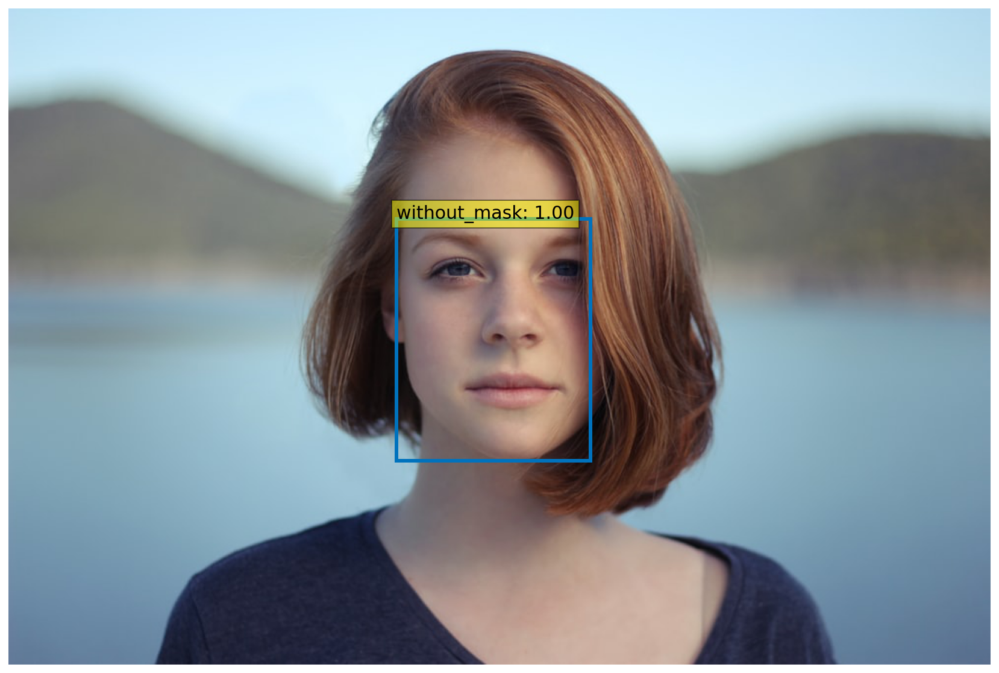

In [ ]:
from PIL import Image

img_name = '/content/drive/MyDrive/[Project]_MachineLearningAndDataAnalytics/testing_images/testing.jpg'
im = Image.open(img_name)

run_worflow(im,model)

/root/.cache/torch/hub/facebookresearch_detr_main/models/position_encoding.py:41: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  dim_t = self.temperature ** (2 * (dim_t // 2) / self.num_pos_feats)


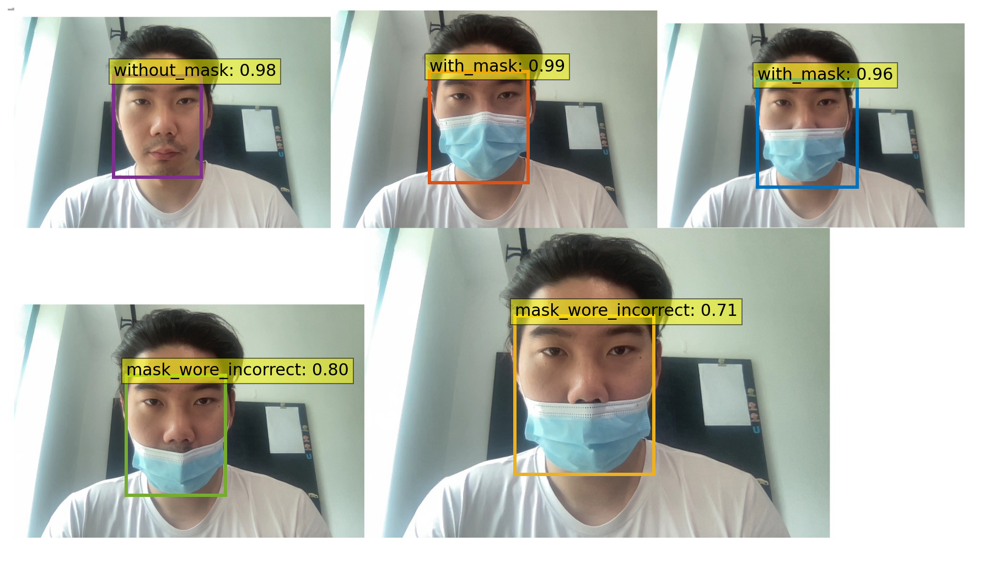

In [ ]:
from PIL import Image

img_name = '/content/drive/MyDrive/[Project]_MachineLearningAndDataAnalytics/testing_images/me6.jpg'
im = Image.open(img_name)

run_worflow(im,model)

/root/.cache/torch/hub/facebookresearch_detr_main/models/position_encoding.py:41: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  dim_t = self.temperature ** (2 * (dim_t // 2) / self.num_pos_feats)


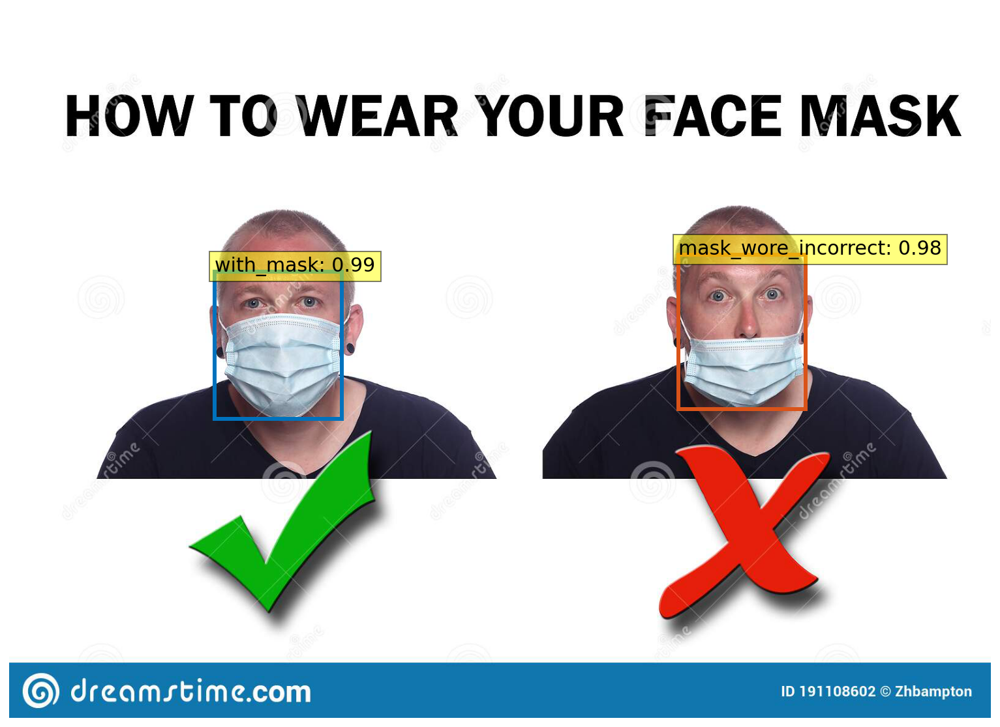

In [ ]:
from PIL import Image

img_name = '/content/drive/MyDrive/[Project]_MachineLearningAndDataAnalytics/testing_images/testing9.jpeg'
im = Image.open(img_name)

run_worflow(im,model)

/root/.cache/torch/hub/facebookresearch_detr_main/models/position_encoding.py:41: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  dim_t = self.temperature ** (2 * (dim_t // 2) / self.num_pos_feats)


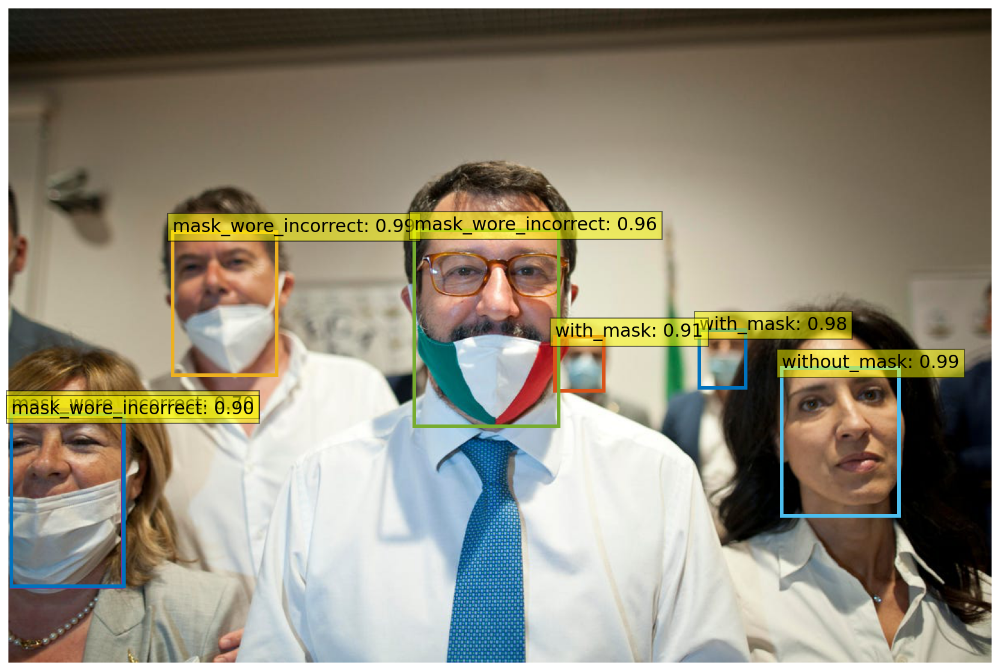

In [ ]:
from PIL import Image

img_name = '/content/drive/MyDrive/[Project]_MachineLearningAndDataAnalytics/testing_images/mask_incorrectly/27.jpeg'
im = Image.open(img_name)

run_worflow(im,model)

/root/.cache/torch/hub/facebookresearch_detr_main/models/position_encoding.py:41: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  dim_t = self.temperature ** (2 * (dim_t // 2) / self.num_pos_feats)


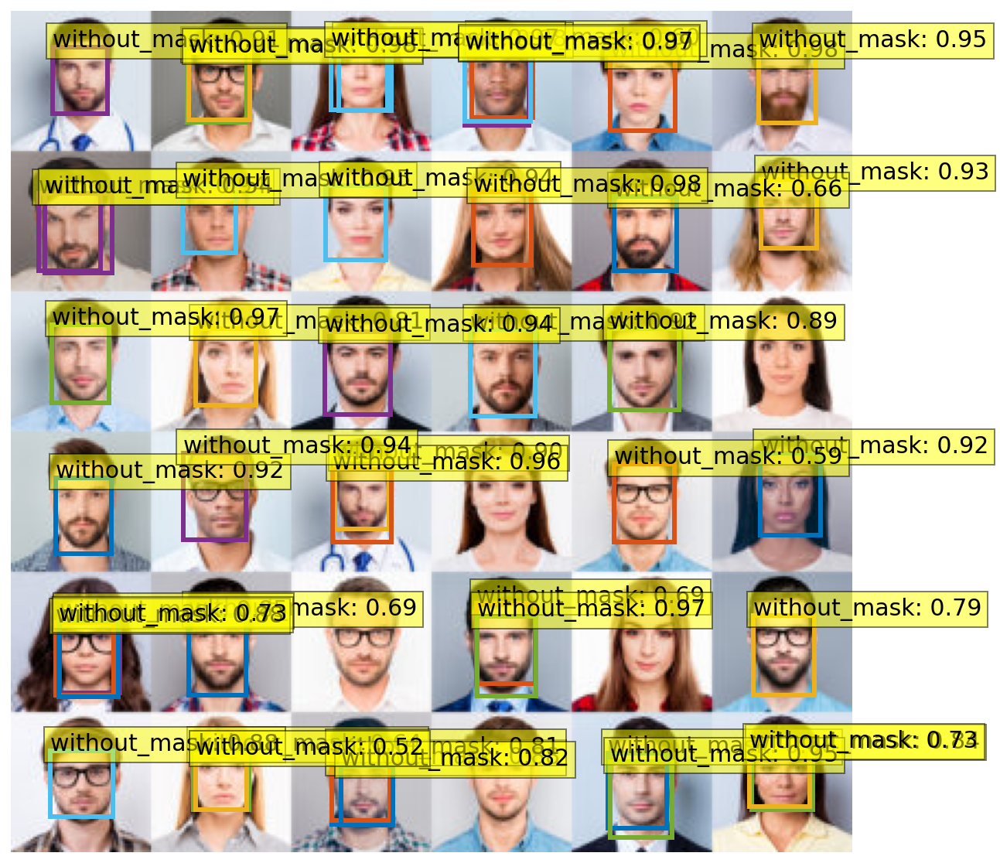

In [ ]:
from PIL import Image

img_name = '/content/drive/MyDrive/[Project]_MachineLearningAndDataAnalytics/testing_images/testing_small.jpeg'
im = Image.open(img_name)

run_worflow(im,model)

In [ ]:
from PIL import Image

img_name = '/content/drive/MyDrive/[Project]_MachineLearningAndDataAnalytics/testing_images/testing_tiny.jpeg'
im = Image.open(img_name)

run_worflow(im,model)

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
from PIL import Image

img_name = '/content/drive/MyDrive/[Project]_MachineLearningAndDataAnalytics/testing_images/testing_big.jpeg'
im = Image.open(img_name)

run_worflow(im,model)

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
from PIL import Image

img_name = '/content/drive/MyDrive/[Project]_MachineLearningAndDataAnalytics/testing_images/thanos.webp'
im = Image.open(img_name)

run_worflow(im,model)

Output hidden; open in https://colab.research.google.com to view.

/root/.cache/torch/hub/facebookresearch_detr_main/models/position_encoding.py:41: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  dim_t = self.temperature ** (2 * (dim_t // 2) / self.num_pos_feats)


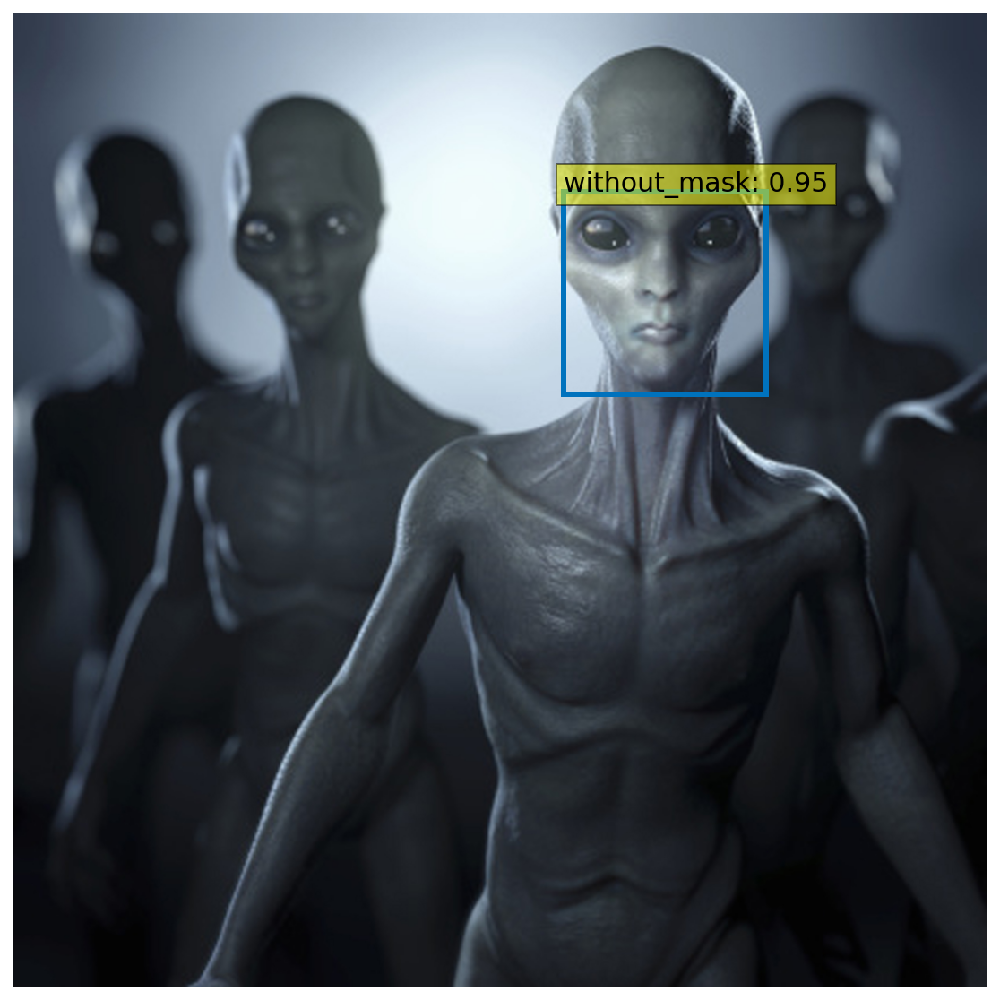

In [ ]:
from PIL import Image

img_name = '/content/drive/MyDrive/[Project]_MachineLearningAndDataAnalytics/testing_images/aliens.jpeg'
im = Image.open(img_name)

run_worflow(im,model)

/root/.cache/torch/hub/facebookresearch_detr_main/models/position_encoding.py:41: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  dim_t = self.temperature ** (2 * (dim_t // 2) / self.num_pos_feats)


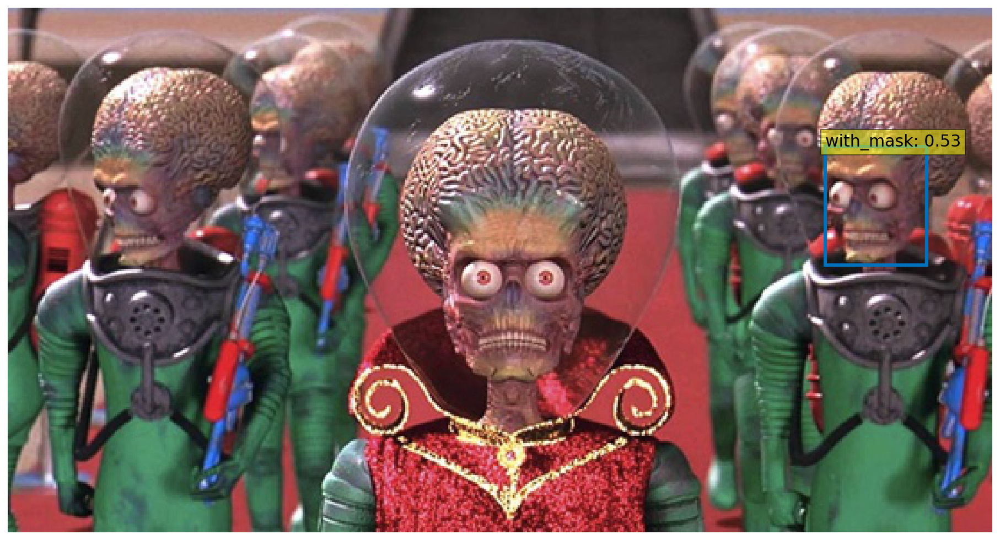

In [ ]:
from PIL import Image

img_name = '/content/drive/MyDrive/[Project]_MachineLearningAndDataAnalytics/testing_images/aliens2.jpeg'
im = Image.open(img_name)

run_worflow(im,model)

##Attention heat maps visualization

In [ ]:
import math

from PIL import Image
import requests
import matplotlib.pyplot as plt
%config InlineBackend.figure_format = 'retina'

import ipywidgets as widgets
from IPython.display import display, clear_output

import torch
from torch import nn
from torchvision.models import resnet50
import torchvision.transforms as T
torch.set_grad_enabled(False);

In [ ]:
# COCO classes
CLASSES = [
      'pic', 'mask_wore_incorrect', 'with_mask', 'without_mask'
  ]

# colors for visualization
COLORS = [[0.000, 0.447, 0.741], [0.850, 0.325, 0.098], [0.929, 0.694, 0.125],
          [0.494, 0.184, 0.556], [0.466, 0.674, 0.188], [0.301, 0.745, 0.933]]

In [ ]:
# standard PyTorch mean-std input image normalization
transform = T.Compose([
    T.Resize(800),
    T.ToTensor(),
    T.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

# for output bounding box post-processing
def box_cxcywh_to_xyxy(x):
    x_c, y_c, w, h = x.unbind(1)
    b = [(x_c - 0.5 * w), (y_c - 0.5 * h),
         (x_c + 0.5 * w), (y_c + 0.5 * h)]
    return torch.stack(b, dim=1)

def rescale_bboxes(out_bbox, size):
    img_w, img_h = size
    b = box_cxcywh_to_xyxy(out_bbox)
    b = b * torch.tensor([img_w, img_h, img_w, img_h], dtype=torch.float32)
    return b

In [ ]:
def plot_results(pil_img, prob, boxes):
    plt.figure(figsize=(16,10))
    plt.imshow(pil_img)
    ax = plt.gca()
    colors = COLORS * 100
    for p, (xmin, ymin, xmax, ymax), c in zip(prob, boxes.tolist(), colors):
        ax.add_patch(plt.Rectangle((xmin, ymin), xmax - xmin, ymax - ymin,
                                   fill=False, color=c, linewidth=3))
        cl = p.argmax()
        text = f'{CLASSES[cl]}: {p[cl]:0.2f}'
        ax.text(xmin, ymin, text, fontsize=15,
                bbox=dict(facecolor='yellow', alpha=0.5))
    plt.axis('off')
    plt.show()

In [ ]:
import torch
model = torch.hub.load('facebookresearch/detr',
                       'detr_resnet50',
                       pretrained=False,
                       num_classes=4)

checkpoint = torch.load('output/checkpoint0099.pth',
                        map_location='cpu')

model.load_state_dict(checkpoint['model'],
                      strict=False)

model.eval();

Using cache found in /root/.cache/torch/hub/facebookresearch_detr_main


In [ ]:
from PIL import Image

img_name = '/content/drive/MyDrive/[Project]_MachineLearningAndDataAnalytics/testing_images/me6.jpg'
im = Image.open(img_name)

In [ ]:
# mean-std normalize the input image (batch-size: 1)
img = transform(im).unsqueeze(0)

# propagate through the model
outputs = model(img)

# keep only predictions with 0.7+ confidence
probas = outputs['pred_logits'].softmax(-1)[0, :, :-1]
keep = probas.max(-1).values > 0.5

# convert boxes from [0; 1] to image scales
bboxes_scaled = rescale_bboxes(outputs['pred_boxes'][0, keep], im.size)

/root/.cache/torch/hub/facebookresearch_detr_main/models/position_encoding.py:41: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  dim_t = self.temperature ** (2 * (dim_t // 2) / self.num_pos_feats)


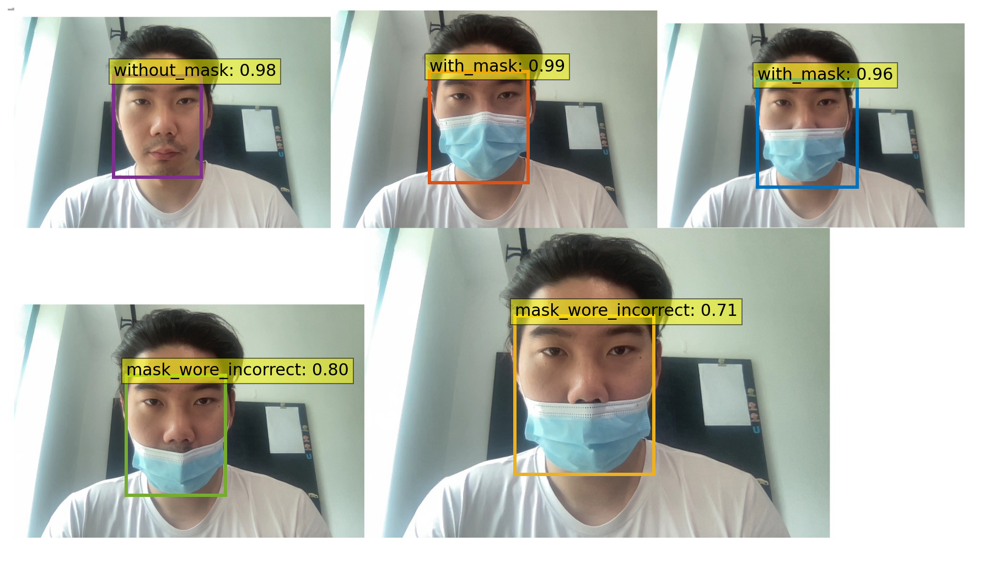

In [ ]:
plot_results(im, probas[keep], bboxes_scaled)

In [ ]:
# use lists to store the outputs via up-values
conv_features, enc_attn_weights, dec_attn_weights = [], [], []

hooks = [
    model.backbone[-2].register_forward_hook(
        lambda self, input, output: conv_features.append(output)
    ),
    model.transformer.encoder.layers[-1].self_attn.register_forward_hook(
        lambda self, input, output: enc_attn_weights.append(output[1])
    ),
    model.transformer.decoder.layers[-1].multihead_attn.register_forward_hook(
        lambda self, input, output: dec_attn_weights.append(output[1])
    ),
]

# propagate through the model
outputs = model(img)

for hook in hooks:
    hook.remove()

# don't need the list anymore
conv_features = conv_features[0]
enc_attn_weights = enc_attn_weights[0]
dec_attn_weights = dec_attn_weights[0]

/root/.cache/torch/hub/facebookresearch_detr_main/models/position_encoding.py:41: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  dim_t = self.temperature ** (2 * (dim_t // 2) / self.num_pos_feats)


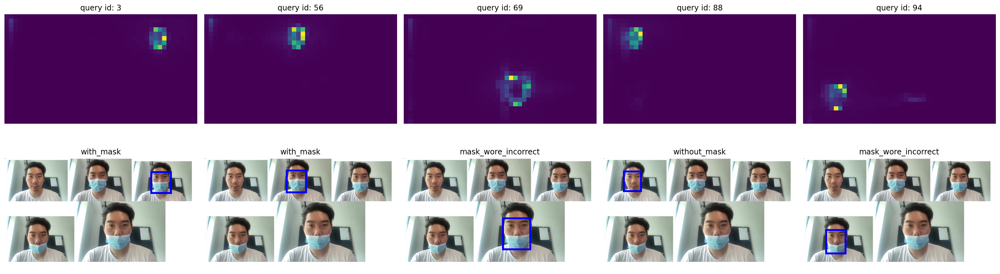

In [ ]:
# get the feature map shape
h, w = conv_features['0'].tensors.shape[-2:]

fig, axs = plt.subplots(ncols=len(bboxes_scaled), nrows=2, figsize=(22, 7))
#colors = COLORS * 100
for idx, ax_i, (xmin, ymin, xmax, ymax) in zip(keep.nonzero(), axs.T, bboxes_scaled):
    ax = ax_i[0]
    ax.imshow(dec_attn_weights[0, idx].view(h, w))
    ax.axis('off')
    ax.set_title(f'query id: {idx.item()}')
    ax = ax_i[1]
    ax.imshow(im)
    ax.add_patch(plt.Rectangle((xmin, ymin), xmax - xmin, ymax - ymin,
                               fill=False, color='blue', linewidth=3))
    ax.axis('off')
    ax.set_title(CLASSES[probas[idx].argmax()])
fig.tight_layout()

In [ ]:
# output of the CNN
f_map = conv_features['0']
print("Encoder attention:      ", enc_attn_weights[0].shape)
print("Feature map:            ", f_map.tensors.shape)

Encoder attention:       torch.Size([1100, 1100])
Feature map:             torch.Size([1, 2048, 25, 44])


In [ ]:
# get the HxW shape of the feature maps of the CNN
shape = f_map.tensors.shape[-2:]
# and reshape the self-attention to a more interpretable shape
sattn = enc_attn_weights[0].reshape(shape + shape)
print("Reshaped self-attention:", sattn.shape)

Reshaped self-attention: torch.Size([25, 44, 25, 44])


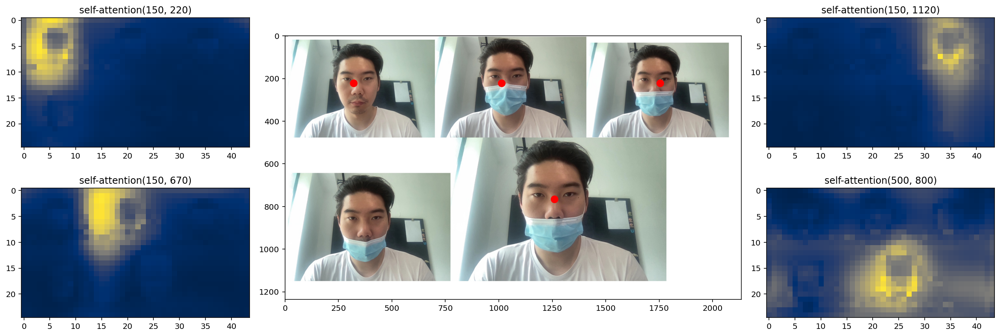

In [ ]:
# downsampling factor for the CNN, is 32 for DETR and 16 for DETR DC5
fact = 32

# let's select 4 reference points for visualization
idxs = [(150, 220), (150, 670), (150, 1120), (500, 800),]

# here we create the canvas
fig = plt.figure(constrained_layout=True, figsize=(25 * 0.7, 8.5 * 0.7))
# and we add one plot per reference point
gs = fig.add_gridspec(2, 4)
axs = [
    fig.add_subplot(gs[0, 0]),
    fig.add_subplot(gs[1, 0]),
    fig.add_subplot(gs[0, -1]),
    fig.add_subplot(gs[1, -1]),
]

# for each one of the reference points, let's plot the self-attention
# for that point
for idx_o, ax in zip(idxs, axs):
    idx = (idx_o[0] // fact, idx_o[1] // fact)
    ax.imshow(sattn[..., idx[0], idx[1]], cmap='cividis', interpolation='nearest')
    #ax.axis('off')
    ax.set_title(f'self-attention{idx_o}')

# and now let's add the central image, with the reference points as red circles
fcenter_ax = fig.add_subplot(gs[:, 1:-1])
fcenter_ax.imshow(im)
for (y, x) in idxs:
    scale = im.height / img.shape[-2]
    x = ((x // fact) + 0.5) * fact
    y = ((y // fact) + 0.5) * fact
    fcenter_ax.add_patch(plt.Circle((x * scale, y * scale), fact // 2, color='r'))
    #fcenter_ax.axis('off')

In [ ]:
class AttentionVisualizer:
    def __init__(self, model, transform):
        self.model = model
        self.transform = transform

        self.url = ""
        self.cur_url = None
        self.pil_img = None
        self.tensor_img = None

        self.conv_features = None
        self.enc_attn_weights = None
        self.dec_attn_weights = None

        self.setup_widgets()

    def setup_widgets(self):
        self.sliders = [
            widgets.Text(
                value='/content/drive/MyDrive/[Project]_MachineLearningAndDataAnalytics/testing_images/me1.jpg',
                placeholder='Type something',
                description='directory (ENTER):',
                disabled=False,
                continuous_update=False,
                layout=widgets.Layout(width='100%')
            ),
            widgets.FloatSlider(min=0, max=0.99,
                        step=0.02, description='X coordinate', value=0.72,
                        continuous_update=False,
                        layout=widgets.Layout(width='50%')
                        ),
            widgets.FloatSlider(min=0, max=0.99,
                        step=0.02, description='Y coordinate', value=0.40,
                        continuous_update=False,
                        layout=widgets.Layout(width='50%')),
            widgets.Checkbox(
              value=False,
              description='Direction of self attention',
              disabled=False,
              indent=False,
              layout=widgets.Layout(width='50%'),
          ),
            widgets.Checkbox(
              value=True,
              description='Show red dot in attention',
              disabled=False,
              indent=False,
              layout=widgets.Layout(width='50%'),
          )
        ]
        self.o = widgets.Output()

    def compute_features(self, img):
        model = self.model
        # use lists to store the outputs via up-values
        conv_features, enc_attn_weights, dec_attn_weights = [], [], []

        hooks = [
            model.backbone[-2].register_forward_hook(
                lambda self, input, output: conv_features.append(output)
            ),
            model.transformer.encoder.layers[-1].self_attn.register_forward_hook(
                lambda self, input, output: enc_attn_weights.append(output[1])
            ),
            model.transformer.decoder.layers[-1].multihead_attn.register_forward_hook(
                lambda self, input, output: dec_attn_weights.append(output[1])
            ),
        ]
        # propagate through the model
        outputs = model(img)

        for hook in hooks:
            hook.remove()

        # don't need the list anymore
        self.conv_features = conv_features[0]
        self.dec_attn_weights = dec_attn_weights[0]
        # get the HxW shape of the feature maps of the CNN
        shape = self.conv_features['0'].tensors.shape[-2:]
        # and reshape the self-attention to a more interpretable shape
        self.enc_attn_weights = enc_attn_weights[0].reshape(shape + shape)
    
    def compute_on_image(self, url):
        if url != self.url:
            self.url = url
            self.pil_img = Image.open(url)
            # mean-std normalize the input image (batch-size: 1)
            self.tensor_img = self.transform(self.pil_img).unsqueeze(0)
            self.compute_features(self.tensor_img)
    
    def update_chart(self, change):
        with self.o:
            clear_output()

            # j and i are the x and y coordinates of where to look at
            # sattn_dir is which direction to consider in the self-attention matrix
            # sattn_dot displays a red dot or not in the self-attention map
            url, j, i, sattn_dir, sattn_dot = [s.value for s in self.sliders]

            fig, axs = plt.subplots(ncols=2, nrows=1, figsize=(9, 4))
            self.compute_on_image(url)

            # convert reference point to absolute coordinates
            j = int(j * self.tensor_img.shape[-1])
            i = int(i * self.tensor_img.shape[-2])

            # how much was the original image upsampled before feeding it to the model
            scale = self.pil_img.height / self.tensor_img.shape[-2]

            # compute the downsampling factor for the model
            # it should be 32 for standard DETR and 16 for DC5
            sattn = self.enc_attn_weights
            fact = 2 ** round(math.log2(self.tensor_img.shape[-1] / sattn.shape[-1]))

            # round the position at the downsampling factor
            x = ((j // fact) + 0.5) * fact
            y = ((i // fact) + 0.5) * fact

            axs[0].imshow(self.pil_img)
            axs[0].axis('off')
            axs[0].add_patch(plt.Circle((x * scale, y * scale), fact // 2, color='r'))

            idx = (i // fact, j // fact)
            
            if sattn_dir:
                sattn_map = sattn[idx[0], idx[1], ...]
            else:
                sattn_map = sattn[..., idx[0], idx[1]]
            
            axs[1].imshow(sattn_map, cmap='cividis', interpolation='nearest')
            if sattn_dot:
                axs[1].add_patch(plt.Circle((idx[1],idx[0]), 1, color='r'))
            axs[1].axis('off')
            axs[1].set_title(f'self-attention{(i, j)}')

            plt.show()
        
    def run(self):
      for s in self.sliders:
          s.observe(self.update_chart, 'value')
      self.update_chart(None)
      url, x, y, d, sattn_d = self.sliders
      res = widgets.VBox(
      [
          url,
          widgets.HBox([x, y]),
          widgets.HBox([d, sattn_d]),
          self.o
      ])
      return res

In [ ]:
w = AttentionVisualizer(model, transform)
w.run()

#**Deformable DETR Fine Tuning**

##Setup

In [ ]:
!nvidia-smi

Wed Mar 30 16:56:51 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.32.03    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   44C    P0    28W / 250W |      2MiB / 16280MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
%cd /content/drive/MyDrive/[Project]_MachineLearningAndDataAnalytics/DEFORM_DETR

/content/drive/MyDrive/[Project]_MachineLearningAndDataAnalytics/DEFORM_DETR


In [ ]:
!git clone https://github.com/fundamentalvision/Deformable-DETR.git

Cloning into 'Deformable-DETR'...
remote: Enumerating objects: 98, done.
remote: Total 98 (delta 0), reused 0 (delta 0), pack-reused 98
Unpacking objects: 100% (98/98), done.


In [ ]:
%cd ./models/ops

/content/drive/MyDrive/[Project]_MachineLearningAndDataAnalytics/DEFORM_DETR/models/ops


In [ ]:
!sh make.sh
%cd ../

running build
running build_py
running build_ext
/usr/local/lib/python3.7/dist-packages/torch/utils/cpp_extension.py:381: UserWarning: Attempted to use ninja as the BuildExtension backend but we could not find ninja.. Falling back to using the slow distutils backend.
  warnings.warn(msg.format('we could not find ninja.'))
running install
running bdist_egg
running egg_info
writing MultiScaleDeformableAttention.egg-info/PKG-INFO
writing dependency_links to MultiScaleDeformableAttention.egg-info/dependency_links.txt
writing top-level names to MultiScaleDeformableAttention.egg-info/top_level.txt
writing manifest file 'MultiScaleDeformableAttention.egg-info/SOURCES.txt'
installing library code to build/bdist.linux-x86_64/egg
running install_lib
creating build/bdist.linux-x86_64/egg
creating build/bdist.linux-x86_64/egg/modules
copying build/lib.linux-x86_64-3.7/modules/ms_deform_attn.py -> build/bdist.linux-x86_64/egg/modules
copying build/lib.linux-x86_64-3.7/modules/__init__.py -> build/b

##Training [100 epochs]

In [ ]:
%cd /content/drive/MyDrive/[Project]_MachineLearningAndDataAnalytics/DEFORM_DETR

/content/drive/MyDrive/[Project]_MachineLearningAndDataAnalytics/DEFORM_DETR


In [ ]:
%cd ./weights

/content/drive/MyDrive/ML_project/DEFORM_kaggle_masks_fine_tune2/weights


In [ ]:
%cd /content/drive/MyDrive/[Project]_MachineLearningAndDataAnalytics/DEFORM_DETR

/content/drive/MyDrive/ML_project/DEFORM_kaggle_masks_fine_tune2


In [ ]:
import torch 
pretrained_weights = torch.load('r50_deformable_detr-checkpoint.pth')

In [ ]:
import torch 
pretrained_weights = torch.load('r50_deformable_detr-checkpoint.pth')
#removing the last otuput layer of the pretrained model
num_classes = 4
del pretrained_weights['model']['class_embed.0.weight']
del pretrained_weights['model']['class_embed.0.bias']
del pretrained_weights['model']['class_embed.1.weight']
del pretrained_weights['model']['class_embed.1.bias']
del pretrained_weights['model']['class_embed.2.weight']
del pretrained_weights['model']['class_embed.2.bias']
del pretrained_weights['model']['class_embed.3.weight']
del pretrained_weights['model']['class_embed.3.bias']
del pretrained_weights['model']['class_embed.4.weight']
del pretrained_weights['model']['class_embed.4.bias']
del pretrained_weights['model']['class_embed.5.weight']
del pretrained_weights['model']['class_embed.5.bias']
del pretrained_weights['model']['query_embed.weight']
torch.save(pretrained_weights, 'r50_deformable_detr-checkpoint_%d_v2.pth'%num_classes)

In [ ]:
%cd /content/drive/MyDrive/[Project]_MachineLearningAndDataAnalytics/DEFORM_DETR

/content/drive/MyDrive/ML_project/DEFORM_kaggle_masks_fine_tune2


In [ ]:
!python3 main.py --dataset_file face --data_path ../Datesets --output_dir output3 --resume weights/r50_deformable_detr-checkpoint_4_v2.pth  --start_epoch 0 --epochs 100

Streaming output truncated to the last 5000 lines.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.485
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.136
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.302
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.317
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.225
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.504
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.645
Epoch: [22]  [  0/350]  eta: 0:02:32  lr: 0.000100  class_error: 0.00  grad_norm: 165.51  loss: 7.9650 (7.9650)  loss_ce: 0.3113 (0.3113)  loss_bbox: 0.2155 (0.2155)  loss_giou: 0.8048 (0.8048)  loss_ce_0: 0.3444 (0.3444)  loss_bbox_0: 0.2331 (0.2331)  loss_giou_0: 0.8195 (0.8195)  loss_ce_1: 0.3218 (0.3218)  loss_bbox_1: 0.2201 (0.2201)  loss_giou_1: 0.8112 (0.8112)  loss_ce_2: 0.3150 

##Plots

In [ ]:
%cd /content/drive/MyDrive/[Project]_MachineLearningAndDataAnalytics/DEFORM_DETR

/content/drive/MyDrive/[Project]_MachineLearningAndDataAnalytics/DEFORM_DETR


In [ ]:
from util.plot_utils import plot_logs
from matplotlib import pyplot as plt
from pathlib import Path

log_directory = [Path('output3/')]

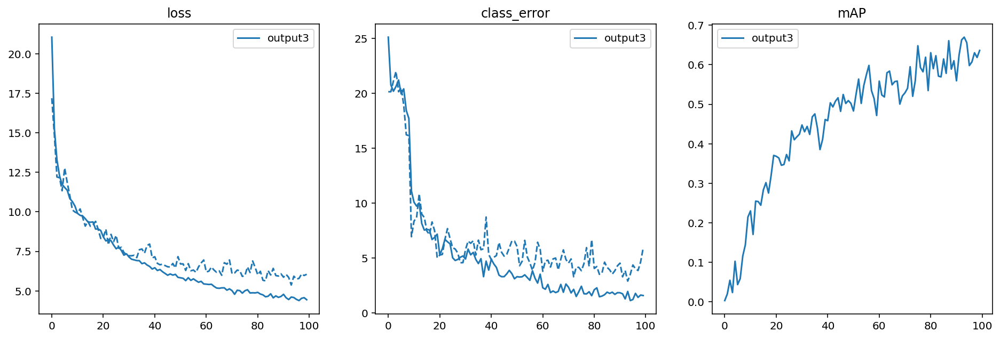

In [ ]:
fields_of_interest = (
    'loss',
    'class_error',
    'mAP',
    )

plot_logs(log_directory,
          fields_of_interest)

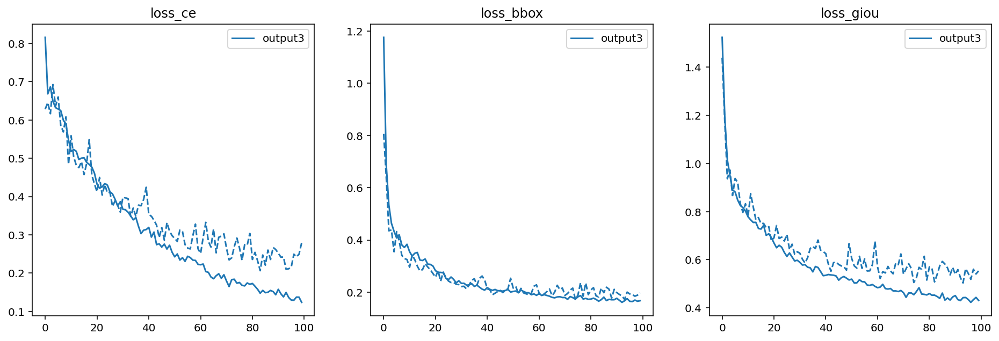

In [ ]:
fields_of_interest = (
    'loss_ce',
    'loss_bbox',
    'loss_giou',
    )

plot_logs(log_directory,
          fields_of_interest)